<a href="https://colab.research.google.com/github/gabrielres10/EDA-Caso-Banco/blob/analisis-univariado-p4/analisis_univariado_p4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Caso Banco (Nivel de riesgo LA/FT)

## Introducción:
La Circular Básica Jurídica (C.E 029/14) en su título IV - capitulo IV, establece que las entidades financieras deben estar en la capacidad de medir el nivel de riesgo que representan sus clientes para el Lavado de Activos y la Financiación del Terrorismo (LAFT), en aras de tomar medidas intensificadas sobre aquellos que representan un nivel de riesgo alto.
El presente proyecto se basa en establecer el nivel de riesgo de LAFT de acuerdo con las características cualitativas y cuantitativas de los clientes con el fin de prevenir la materialización de riesgos de LAFT, teniendo un impacto alto para la organización dado que es un proyecto transversal a la misma.

## Integrantes:

* JAISON AVILA RIVERA
* GABRIEL RESTREPO GIRALDO
* SEBASTIAN GONZALEZ PACHÓN
* MARIA JOSE CAICEDO CORTES

** Index(['ID', 'NIVEL RIESGO ACT ECONOMICA', 'CODIGO DE ACTIVIDAD ECONOMICA',
       'USUARIO/CLIENTE', 'SERVIDOR PUBLICO PEP',
       'ACRM - MONTO DE OPERACION MN', 'ACRM - MONTO EFECTIVO MN',
       'PRODUCTOS CAP-COL', 'ACRM - DEBITO-CREDITO'],
      dtype='object')

# Análisis univariado de columna CODIGO DE ACTIVIDAD ECONOMICA

##¿Por qué es importante ?



##¿Cómo puede influir en la toma de decisiones?



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns

from scipy.stats import norm
from scipy import stats

In [ ]:
#cargar dataset
df1 = pd.read_csv('Journal Personas.csv', sep=',',encoding='latin-1')
df2 = pd.read_csv('Journal transaccional.csv', sep=',',encoding='latin-1')

C:\Users\57317\AppData\Local\Temp\ipykernel_3780\2189596087.py:2: DtypeWarning: Columns (4,9,10,14,17,23,25,51) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv('Journal Personas.csv', sep=',',encoding='latin-1')
C:\Users\57317\AppData\Local\Temp\ipykernel_3780\2189596087.py:3: DtypeWarning: Columns (5,13,15,17,34,35,39,43,44,45,54,78,79,84,85) have mixed types. Specify dtype option on import or set low_memory=False.
  df2 = pd.read_csv('Journal transaccional.csv', sep=',',encoding='latin-1')


In [ ]:
df1.head()

,ID,TIPO DE PERSONA N-J,FECHA EXPEDICION ID,CIUDAD EXPEDICION ID,DEPARTAMENTO EXPEDICION ID,FECHA APERTURA,OFICINA APERTURA,SUCURSAL APERTURA,CANAL DE VINCULACION,BANCA,...,ACRM SEGMENTO - NIVEL DE RIESGO CIIU,PRODUCTOS CAP-COL,PATRIMONIO,INGRESOS NETOS,ULTIMO PAIS,RIESGO ULTIMO PAIS,DEBITOS 30 DIAS,CREDITOS 30 DIAS,NIVEL RIESGO ACT ECONOMICA,ESP RANGO ANOS DE CONSTITUCION
0,1,N,20220423,BOGOTA,NaN,20230908,99999,99999,1,NaN,...,NaN,0,1000000.0,300000.0,ABW,MEDIO,0.0,0.0,MEDIO,5
1,2,N,20210516,BOGOTA,NaN,20220324,99999,99999,1,NaN,...,NaN,0,100000.0,0.0,628,BAJO,0.0,0.0,MEDIO,5
2,3,N,20220805,BOGOTA,NaN,20230915,99999,99999,1,NaN,...,NaN,0,10000000.0,600000.0,PRI,BAJO,0.0,0.0,BAJO,5
3,4,N,20160408,BOGOTA,NaN,20211204,99999,99999,1,NaN,...,NaN,0,10000000.0,300000.0,CRI,MEDIO,0.0,0.0,MEDIO,5
4,4,N,20160408,BOGOTA,NaN,20211204,99999,99999,1,NaN,...,NaN,0,10000000.0,300000.0,CRI,MEDIO,0.0,0.0,MEDIO,5


In [ ]:
df2.rename(columns={'ID Anónima':'ID'}, inplace=True)
df2.head()

,ID,GENERO ALERTA,CONDICIONES,ACRM - INGRESOS MENSUALES,ACRM - SEGMENTO DEL CLIENTE,ACRM - MOTIVO CONCEPTO,ACRM - CODIGO TRANSACCION,ACRM - DEBITO-CREDITO,ACRM - OFICINA TRANSACCION,ACRM - SUCURSAL TRANSACCION,...,ACRM - SEGMENTO JURISDICCION INTERNACIONAL,ACRM - PUNTOCORTEGE JURISDICCION INTERNACIONAL,ACRM - PUNTOCORTEGR JURISDICCION INTERNACIONAL,ACRM - REFERENCIA PRODUCTO,EPJ: PUNTOCORTEDB,EPJ: PUNTOCORTECR,EPJ:PUNTOCORTEGE,EPJ:PUNTOCORTEGR,P_R.TRANSACCION - 0 A 1000 -,P_PROMEDIO R.RESIDUAL Y R.TRX
0,2683,0,"0307,0308,0310,0401,0402,0403,0825,0846,0960,0...",0,USUARIO DE REMESAS,NaN,NaN,R,162,162,...,NaN,0,0,REM,51,40,62,169,300,359.31
1,2313,0,"0307,0308,0310,0401,0402,0403,0825,0846,0960,0...",0,USUARIO DE REMESAS,NaN,NaN,R,162,162,...,NaN,0,0,REM,51,40,62,169,300,350.91
2,4267,0,"0307,0308,0310,0401,0402,0403,0825,0846,0960,0...",800000,NO SEGMENTADO,NaN,NaN,R,162,162,...,NaN,0,0,REM,51,40,62,169,300,359.31
3,4730,0,"0307,0308,0310,0401,0402,0403,0825,0846,0960,0...",0,USUARIO DE REMESAS,NaN,NaN,R,162,162,...,NaN,0,0,REM,51,40,62,169,300,350.91
4,2729,0,"0307,0308,0310,0401,0402,0403,0825,0846,0960,0...",0,USUARIO DE REMESAS,NaN,NaN,R,162,162,...,NaN,0,0,REM,51,40,62,169,300,359.31


In [ ]:
df1.shape
df2.shape
print(df1.shape)
print(df2.shape)

(35533, 69)
(44084, 95)


In [ ]:
#imprimir cómo sería realmente la dimensionalidad de la unión en el mejor de los casos
print("Dimensionalidad en el mejor de los casos: ", (df1.shape[0], df1.shape[1] + df2.shape[1] - 1))

Dimensionalidad en el mejor de los casos:  (35533, 163)


In [ ]:
#como hay duplicados, borramos las filas duplicadas en ambos conjuntos de datos. Guardamos el resultado en nuevos dataframes
df1_unique = df1.drop_duplicates(subset='ID')

In [ ]:

#unir los dos dataset por la columna 'ID'
df = pd.merge(df1_unique, df2, on='ID', how='inner')

In [ ]:
#conteo de valores nulos
nulos = df.isnull().sum()

#ordenar los valores nulos de mayor a menor
nulos = nulos.sort_values(ascending=False)

#visualizar más columnas
pd.set_option('display.max_rows', None)
print (nulos)

PERSONA NATURAL C/COMERCIO                           44084
CLASE DE CLIENTE                                     44084
ACRM SEGMENTO - NIVEL DE RIESGO CIIU                 44084
ACRM - SEGMENTO PEP                                  44084
ACRM - NIVEL RIESGO JURIDICCION                      44084
ACRM - SEGMENTO DE JURIDICCION                       44084
ACRM - CODIGO PAIS ORIGEN DE TRANSACCION             44036
ACRM - RESERVADO ALFA  7                             43771
ACRM - SEGMENTO JURISDICCION INTERNACIONAL           42460
EMPRESA DONDE LABORA                                 30378
ACRM - RESERVADO ALFA  5                             25986
ACRM - NIVEL DE RIESGO JURISDICCION INTERNACIONAL    25190
ACRM - RESERVADO ALFA  6                             24610
ACRM - CIUDAD DESTINO TRANSACCION                    24610
ACRM - RESERVADO ALFA  2                             24610
ACRM - PAIS ORDENANTE / BENEFICIARIO                 24610
ULTIMO PAIS                                          245

In [ ]:
#eliminar todas las columnas excepto 'ID', 'NIVEL RIESGO ACT ECONOMICA', 'CODIGO DE ACTIVIDAD ECONOMICA', 'USUARIO/CLIENTE', 'SERVIDOR PUBLICO PEP'...
data = df[['ID', 'NIVEL RIESGO ACT ECONOMICA', 'CODIGO DE ACTIVIDAD ECONOMICA', 'USUARIO/CLIENTE', 'SERVIDOR PUBLICO PEP', 'ACRM - MONTO DE OPERACION MN', 'ACRM - MONTO EFECTIVO MN','PRODUCTOS CAP-COL','ACRM - DEBITO-CREDITO']]
data

,ID,NIVEL RIESGO ACT ECONOMICA,CODIGO DE ACTIVIDAD ECONOMICA,USUARIO/CLIENTE,SERVIDOR PUBLICO PEP,ACRM - MONTO DE OPERACION MN,ACRM - MONTO EFECTIVO MN,PRODUCTOS CAP-COL,ACRM - DEBITO-CREDITO
0,1,MEDIO,9820,CLIENTE,N,1.043824e+06,1.043824e+06,0,R
1,2,MEDIO,9820,CLIENTE,N,7.055870e+05,7.055870e+05,0,R
2,2,MEDIO,9820,CLIENTE,N,1.012981e+07,1.012981e+07,0,R
3,3,BAJO,4729,CLIENTE,N,1.211157e+06,1.211157e+06,0,R
4,4,MEDIO,9820,CLIENTE,N,0.000000e+00,1.218900e+05,0,R
5,4,MEDIO,9820,CLIENTE,N,0.000000e+00,1.012500e+05,0,R
6,5,MEDIO,81,CLIENTE,N,7.121640e+05,7.121640e+05,0,R
7,6,MEDIO,81,CLIENTE,N,5.915000e+04,5.915000e+04,0,R
8,6,MEDIO,81,CLIENTE,N,0.000000e+00,1.506000e+05,0,R
9,6,MEDIO,81,CLIENTE,N,1.590500e+05,1.590500e+05,0,R


In [ ]:
#Eliminar filas donde la columna "ACRM - DEBITO-CREDITO" contenga R o E
data = data[data['ACRM - DEBITO-CREDITO'] != 'R']
data = data[data['ACRM - DEBITO-CREDITO'] != 'E']

#Eliminar filas donde la columna "CODIGO DE ACTIVIDAD ECONOMICA" sea igual a 999999
data = data[data['CODIGO DE ACTIVIDAD ECONOMICA'] != 999999]

In [ ]:
data.shape

(24610, 9)

In [ ]:
#Reemplazar variables en columna "NIVEL RIESGO ACT ECONOMICA"
data['NIVEL RIESGO ACT ECONOMICA'] = data['NIVEL RIESGO ACT ECONOMICA'].replace('BAJO', 0)
data['NIVEL RIESGO ACT ECONOMICA'] = data['NIVEL RIESGO ACT ECONOMICA'].replace('MEDIO', 1)
data['NIVEL RIESGO ACT ECONOMICA'] = data['NIVEL RIESGO ACT ECONOMICA'].replace('ALTO', 2)

#Reemplazar variables en columna "USUARIO/CLIENTE"
#BORRAR VARIABLE
data['USUARIO/CLIENTE'] = data['USUARIO/CLIENTE'].replace('CLIENTE', 0)
data['USUARIO/CLIENTE'] = data['USUARIO/CLIENTE'].replace('USUARIO', 1)

#Reemplazar variables en columna "SERVIDOR PUBLICO PEP"
data['SERVIDOR PUBLICO PEP'] = data['SERVIDOR PUBLICO PEP'].replace('N', 0)
data['SERVIDOR PUBLICO PEP'] = data['SERVIDOR PUBLICO PEP'].replace('S', 1)

#Reemplazar variables en columna "ACRM - DEBITO-CREDITO"
data['ACRM - DEBITO-CREDITO'] = data['ACRM - DEBITO-CREDITO'].replace('C', 0)
data['ACRM - DEBITO-CREDITO'] = data['ACRM - DEBITO-CREDITO'].replace('D', 1)

C:\Users\57317\AppData\Local\Temp\ipykernel_3780\418588015.py:4: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  data['NIVEL RIESGO ACT ECONOMICA'] = data['NIVEL RIESGO ACT ECONOMICA'].replace('ALTO', 2)
C:\Users\57317\AppData\Local\Temp\ipykernel_3780\418588015.py:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  data['USUARIO/CLIENTE'] = data['USUARIO/CLIENTE'].replace('USUARIO', 1)
C:\Users\57317\AppData\Local\Temp\ipykernel_3780\418588015.py:12: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in

In [ ]:
data.head()

,ID,NIVEL RIESGO ACT ECONOMICA,CODIGO DE ACTIVIDAD ECONOMICA,USUARIO/CLIENTE,SERVIDOR PUBLICO PEP,ACRM - MONTO DE OPERACION MN,ACRM - MONTO EFECTIVO MN,PRODUCTOS CAP-COL,ACRM - DEBITO-CREDITO
515,262,0.0,9602,0.0,0,20000.00,20000.00,1,0
1089,562,1.0,9820,0.0,0,50489.51,50489.51,2,0
1090,562,1.0,9820,0.0,0,75700.50,50489.51,2,0
1431,805,0.0,1089,1.0,0,1063170.00,1063170.00,2,0
1432,805,0.0,1089,1.0,0,1098170.00,1098170.00,2,0


In [ ]:
data.shape

(24610, 9)

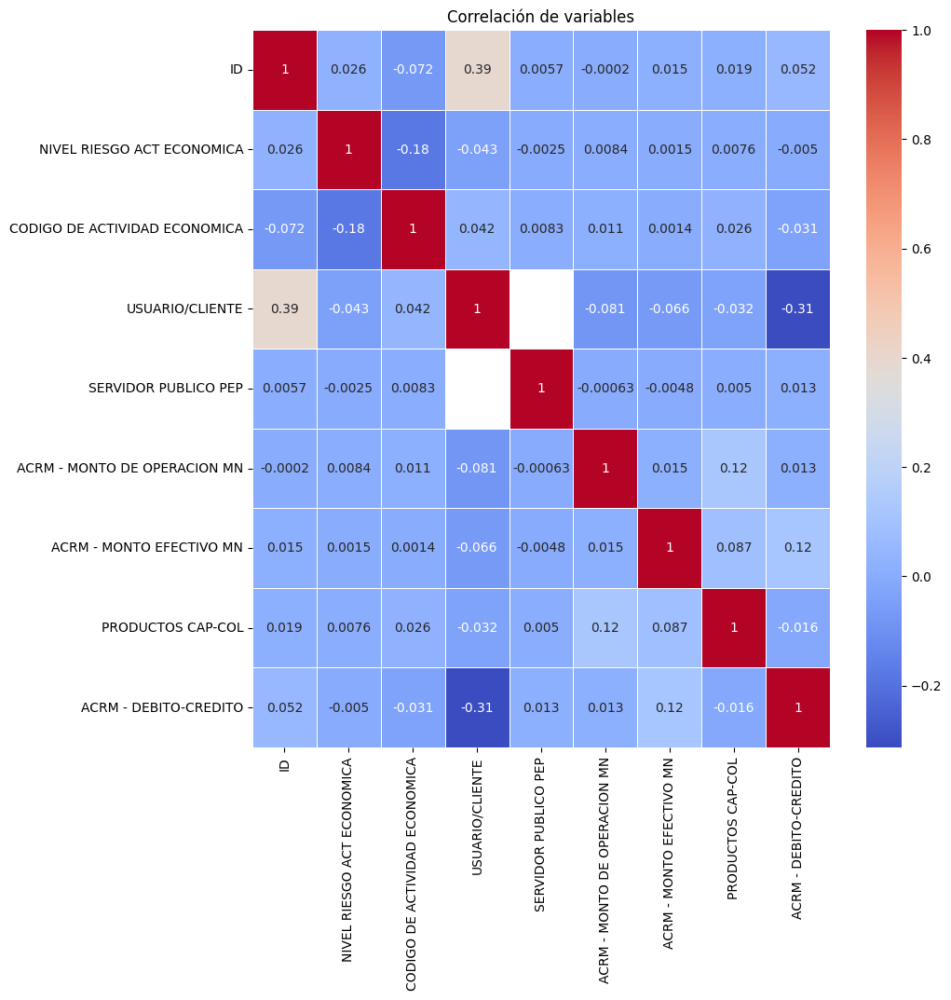

In [ ]:
#Gráfico de correlación
plt.figure(figsize=(10,10))

#Matriz de correlación
correlacion = data.corr()
correlacion

#Mapa de calor
sns.heatmap(correlacion, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlación de variables')
plt.show()


#  **ANÁLISIS UNIVARIADO**

## **CÓDIGO DE ACTIVIDAD ECONÓMICA**      


### Análisis de Estadísticas Descriptivas

In [ ]:
data['CODIGO DE ACTIVIDAD ECONOMICA'].describe()

count    24610.000000
mean      4716.993458
std       2815.410484
min         10.000000
25%       4520.000000
50%       4729.000000
75%       5611.000000
max      99999.000000
Name: CODIGO DE ACTIVIDAD ECONOMICA, dtype: float64

In [ ]:
print("------- Análisis estadístico de la mediana -------")
data['CODIGO DE ACTIVIDAD ECONOMICA'].median()

------- Análisis estadístico de la mediana -------


np.float64(4729.0)

En este caso, la mediana no es una medida de tendencia signficativa, debido a que esta es una variable cualitativa sin escala ordinal. Pasamos a analizar la moda.

In [ ]:
print("------- Análisis estadístico de la moda -------")
data['CODIGO DE ACTIVIDAD ECONOMICA'].mode()

------- Análisis estadístico de la moda -------


0    9602
Name: CODIGO DE ACTIVIDAD ECONOMICA, dtype: int64

Esto nos indica que el Código de Actividad Económica que más se repite es el 9820, lo que quiere decir que la mayoría de clientes o usuarios se dedican a actividades de los hogares que producen diversos servicios para su propia subsistencia. Según la DIAN,  dentro de estas actividades se incluye la cocina, la enseñanza, el cuidado de los miembros de la familia y otros servicios prestados por el hogar para su propio sostenimiento. Si los hogares se dedican también a la producción de bienes diversos, utilizados para su propia subsistencia, se clasifican dentro de las actividades no diferenciadas, de hogares privados, como productores de dichos bienes para uso propio.

### Antes de tratamiento de datos atípicos

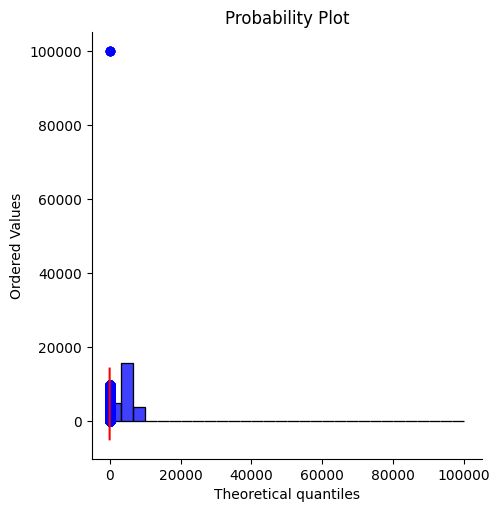

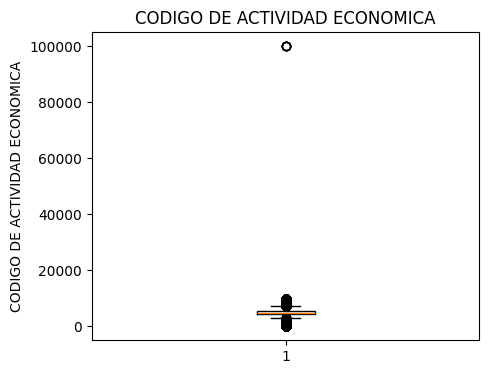

In [ ]:
# Histograma:

sns.displot(data['CODIGO DE ACTIVIDAD ECONOMICA'], kde = False, color = 'blue', bins = 30)
plt.title('CODIGO DE ACTIVIDAD ECONOMICA')
plt.xlabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.ylabel('Frecuencia')
res = stats.probplot(data['CODIGO DE ACTIVIDAD ECONOMICA'], plot = plt)

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['CODIGO DE ACTIVIDAD ECONOMICA'])
plt.ylabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.title('CODIGO DE ACTIVIDAD ECONOMICA')
plt.show()


### Interpretación:

De acuerdo con las gráficas, se identifica un valor atípico principal, el cual afecta el análisis de los datos y sesga completamente el estudio, debido a que no existe un Código de Actividad Económica "99999", por lo cual podríamos determinar que es un error de digitación o un dato errado, y no podríamos conocer cuál es el correcto. Es por esto que lo mejor sería proceder a eliminar las filas que contengan este valor (5 en total)

Procedemos a eliminar las filas que contengan datos atípicos en la columna Código de Actividad Económica:

In [ ]:
# Se eliminan las filas que contenga el valor de 99999 en la columna "CODIGO DE ACTIVIDAD ECONOMICA"
data_limpio = data[data['CODIGO DE ACTIVIDAD ECONOMICA'] != 99999]

data_limpio.shape

(24605, 9)

### Sesgos o Patrones dentro de los datos

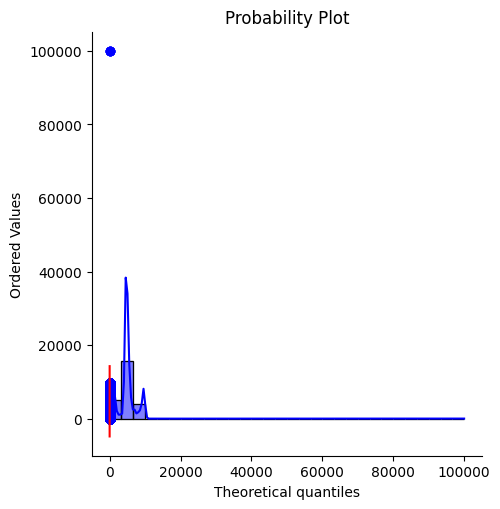

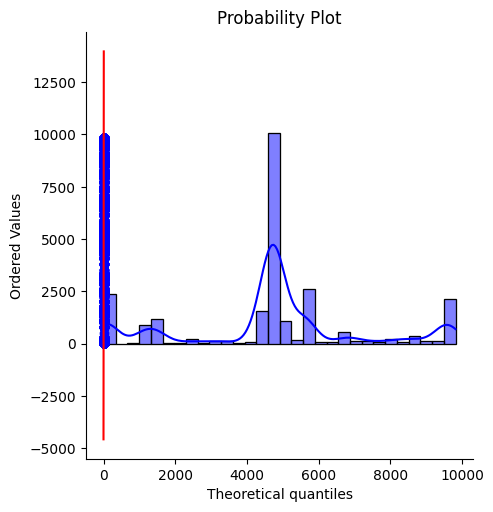

In [ ]:
#Histograma con valor atípico principal

sns.displot(data['CODIGO DE ACTIVIDAD ECONOMICA'], kde = True, color = 'blue', bins = 30)
plt.title('CODIGO DE ACTIVIDAD ECONOMICA')
plt.xlabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.ylabel('Frecuencia')
res = stats.probplot(data['CODIGO DE ACTIVIDAD ECONOMICA'], plot = plt)

#Histograma con valor atípico eliminado
sns.displot(data_limpio['CODIGO DE ACTIVIDAD ECONOMICA'], kde = True, color = 'blue', bins = 30)
plt.title('CODIGO DE ACTIVIDAD ECONOMICA')
plt.xlabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.ylabel('Frecuencia')
res = stats.probplot(data_limpio['CODIGO DE ACTIVIDAD ECONOMICA'], plot = plt)


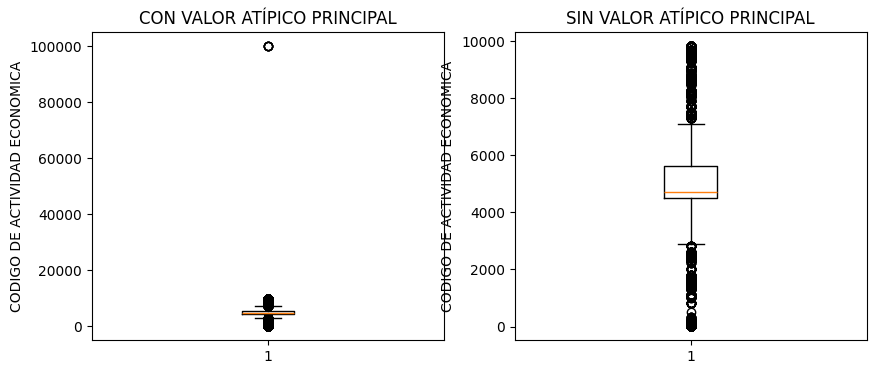

In [ ]:
plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.boxplot(data['CODIGO DE ACTIVIDAD ECONOMICA'])
plt.ylabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.title('CON VALOR ATÍPICO PRINCIPAL')

plt.subplot(1, 2, 2)
plt.boxplot(data_limpio['CODIGO DE ACTIVIDAD ECONOMICA'])
plt.ylabel('CODIGO DE ACTIVIDAD ECONOMICA')
plt.title('SIN VALOR ATÍPICO PRINCIPAL')

plt.show()


## CONCLUSIONES

Se puede observar que al eliminar el dato atípico que consideramos "principal", surgen una cantidad de datos que se pudiesen considerar también "atípicos". Sin embargo, es importante tener en cuenta que la variable que se está analizando es realmente un código que identifica particularmente la actividad a la que se dedican los clientes y usuarios, no es una variable categórica, tampoco es una variable continua ni ordinal, por lo tanto, estamos analizando hasta 336 características diferentes de una misma variable, en este caso no podríamos considerar que existan datos atípicos, más allá del ya expuesto dato "atípico principal".

## **VARIABLE "USUARIO/CLIENTE"**      

In [ ]:
data['USUARIO/CLIENTE'].describe()

count    127.000000
mean       0.401575
std        0.492158
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max        1.000000
Name: USUARIO/CLIENTE, dtype: float64

In [ ]:
data['USUARIO/CLIENTE'].value_counts()

USUARIO/CLIENTE
0.0    76
1.0    51
Name: count, dtype: int64

La primera impresión con esta variable, es que solo 127 clientes o usuarios del banco se encuentran tipificados como tal. Por lo tanto, un análisis estadístico sobre esta variable no es de mayor utilidad. Ya que existen 24537 "personas o usuarios" sin esta característica, se decidió que se incluirán a todos los clientes en un mismo grupo, tipificado como "Clientes".

## **VARIABLE "SERVIDOR PÚBLICO PEP"**

In [ ]:
data['SERVIDOR PUBLICO PEP'].describe()

count    24610.000000
mean         0.000853
std          0.029200
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: SERVIDOR PUBLICO PEP, dtype: float64

In [ ]:
data['SERVIDOR PUBLICO PEP'].value_counts()

SERVIDOR PUBLICO PEP
0    24589
1       21
Name: count, dtype: int64

Como se puede observar, de los 24610 clientes/usuarios del banco, tan solo 21 corresponden a Personas Expuestas Políticamente y el resto de personas no cuentan con esta condición. Sin embargo, no es posible considerar que las 21 personas que no son PEP, sean datos atípicos, pues es una variable relevante según el análisis de correlación, para la clasificación final que se busca en este proyecto. Es por eso que se debe decidir si la variable es tenida en cuenta con estas características o es descartable para efectos de la clasificación.

In [ ]:
data['ACRM - MONTO DE OPERACION MN'].describe()

,ACRM - MONTO DE OPERACION MN
count,2.461000e+04
mean,7.131703e+06
std,3.126199e+08
min,0.000000e+00
25%,4.130158e+03
50%,1.000000e+05
75%,4.859100e+05
max,3.500000e+10


<ipython-input-51-d93445eff3de>:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['ACRM - MONTO DE OPERACION MN'], fit=norm)


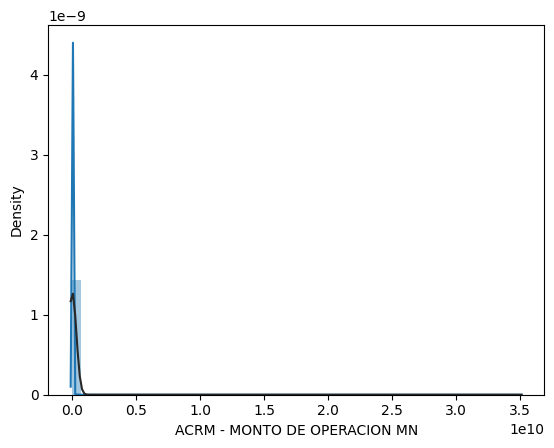

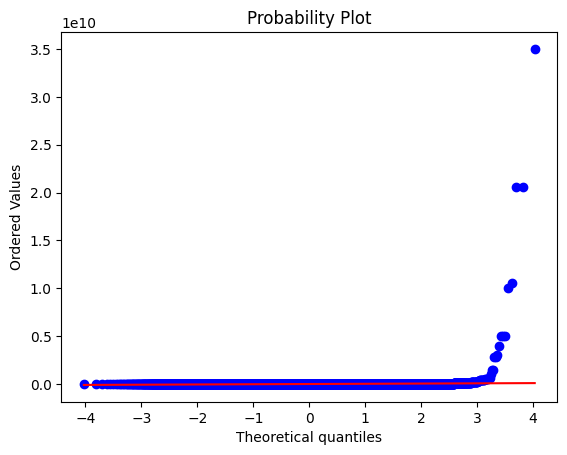

In [ ]:
# Histograma:

from scipy.stats import norm
from scipy import stats


sns.distplot(data['ACRM - MONTO DE OPERACION MN'], fit=norm)
fig = plt.figure()
res = stats.probplot(data['ACRM - MONTO DE OPERACION MN'], plot = plt)


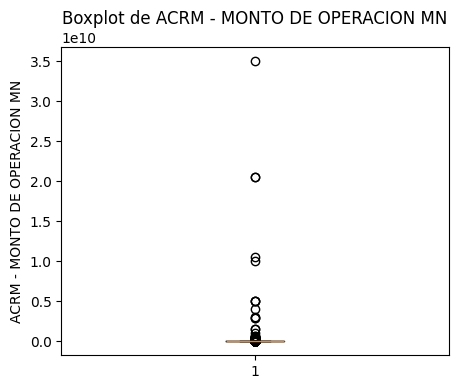

In [ ]:
#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['ACRM - MONTO DE OPERACION MN'])
plt.ylabel('ACRM - MONTO DE OPERACION MN')
plt.title('Boxplot de ACRM - MONTO DE OPERACION MN')
plt.show()


In [ ]:
# Asimetría y curtosis:

print("Skewness: %f" % data['ACRM - MONTO DE OPERACION MN'].skew())
print("Kurtosis: %f" % data['ACRM - MONTO DE OPERACION MN'].kurt())

Skewness: 83.553675
Kurtosis: 7991.635033


In [ ]:
#NORMALIZAR DATOS
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_trans = scaler.fit_transform(data['ACRM - MONTO DE OPERACION MN'].values.reshape(-1, 1))

In [ ]:
upper_limit = data['ACRM - MONTO DE OPERACION MN'].mean() + 3*data['ACRM - MONTO DE OPERACION MN'].std()
lower_limit = data['ACRM - MONTO DE OPERACION MN'].mean() - 3* data['ACRM - MONTO DE OPERACION MN'].std()
print(lower_limit)
print(upper_limit)

-930727932.5079702
944991337.9393216


In [ ]:
a = np.arange(10)
print(type(a))
print (a)

# si se cumple la condición "a<5" se coloca el valor de a (0,1,2,3,4) cuando no se cumple la condición se aplica la segunda formula 10*a (50,60,70,80,90)
b = np.where(a < 1 , a, 1*a)
print(b)

<class 'numpy.ndarray'>
[0 1 2 3 4 5 6 7 8 9]
[0 1 2 3 4 5 6 7 8 9]


In [ ]:
# cuando df['fare_amount'] > upper_limit colocar upper limit
# cuando df['fare_amount'] < lower_limit colocar lower_limit

data['ACRM - MONTO DE OPERACION MN'] = np.where(data['ACRM - MONTO DE OPERACION MN'] > upper_limit, upper_limit, np.where( data['ACRM - MONTO DE OPERACION MN'] < lower_limit,lower_limit, data['ACRM - MONTO DE OPERACION MN']))

In [ ]:
data['ACRM - MONTO DE OPERACION MN'].describe()

,ACRM - MONTO DE OPERACION MN
count,2.461000e+04
mean,2.492807e+06
std,2.768387e+07
min,0.000000e+00
25%,4.130158e+03
50%,1.000000e+05
75%,4.859100e+05
max,9.449913e+08


Se truncaron las últimas líneas 5000 del resultado de transmisión.
36541              NaN                     0                  7.665000e+06   
36544              NaN                     0                  1.938516e+07   
36547              NaN                     0                  1.769493e+06   
36548              NaN                     0                  4.979000e+06   
36549              NaN                     0                  5.655164e+06   
36550              NaN                     0                  5.655164e+06   
36553              NaN                     0                  7.183667e+06   
36592              NaN                     0                  3.901440e+06   
36593              NaN                     0                  3.901440e+06   
36594              NaN                     0                  3.901440e+06   
36596              NaN                     0                  2.394000e+06   
36667              NaN                     0                  2.513144e+06 

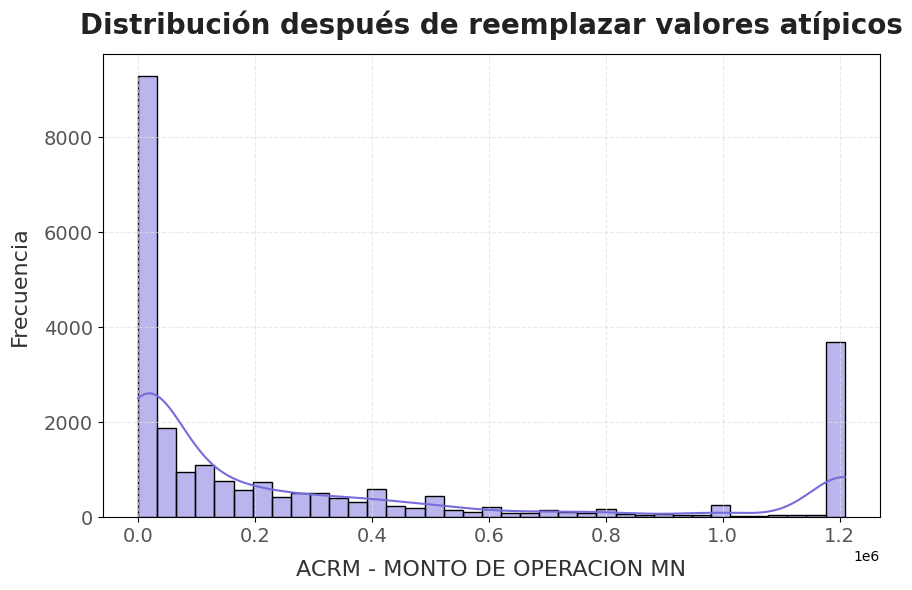

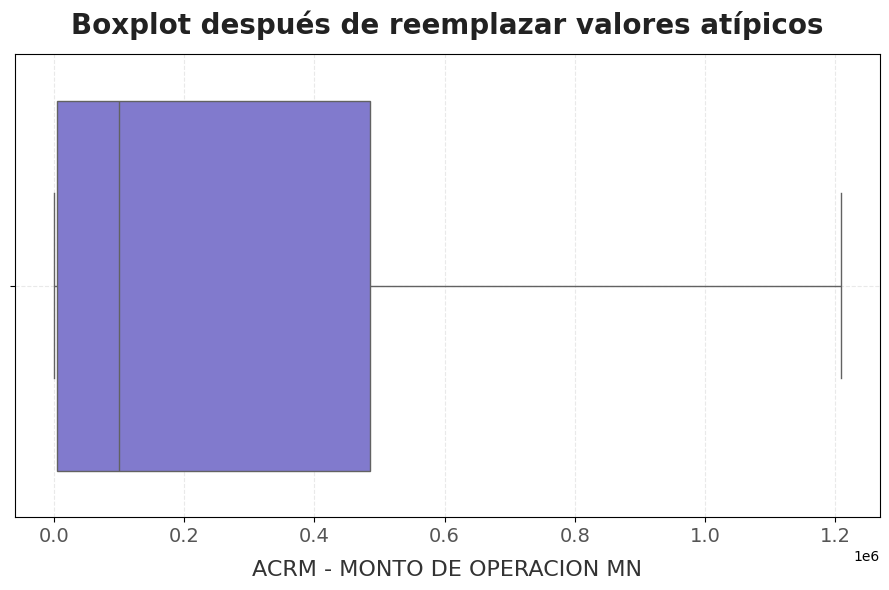

Comparación de estadísticas:
Antes de la limpieza:
                 ID  FECHA EXPEDICION ID  FECHA APERTURA  OFICINA APERTURA  \
count  44084.000000         4.408400e+04    4.408400e+04      44084.000000   
mean   12634.654659         1.867252e+07    2.020942e+07      44358.502790   
std     6564.223104         5.017998e+06    4.715191e+04      49641.674211   
min        1.000000         0.000000e+00    1.971010e+07          1.000000   
25%     7036.750000         1.987031e+07    2.020011e+07         55.000000   
50%    13736.500000         2.002061e+07    2.023033e+07        128.000000   
75%    18164.000000         2.014082e+07    2.024071e+07      99999.000000   
max    23244.000000         2.025022e+07    2.025022e+07      99999.000000   

       SUCURSAL APERTURA  CANAL DE VINCULACION  CLASE DE CLIENTE  \
count       44084.000000          44084.000000               0.0   
mean        44358.502790              4.546752               NaN   
std         49641.674211              4.95

In [ ]:
# Método 1: Detección de valores atípicos usando el rango intercuartílico (IQR)
Q1 = data['ACRM - MONTO DE OPERACION MN'].quantile(0.25)
Q3 = data['ACRM - MONTO DE OPERACION MN'].quantile(0.75)
IQR = Q3 - Q1

# Definir los límites para los valores atípicos
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

print("Límites para valores atípicos:")
print(f"Límite inferior: {limite_inferior}")
print(f"Límite superior: {limite_superior}")

# Identificar los valores atípicos
valores_atipicos = data[(data['ACRM - MONTO DE OPERACION MN'] < limite_inferior) | (data['ACRM - MONTO DE OPERACION MN'] > limite_superior)]
print("\
Valores atípicos identificados:")
print(valores_atipicos)
print(f"Número de valores atípicos: {len(valores_atipicos)}")

# Método 2: Reemplazar los valores atípicos
df_limpio = data.copy()

# Opción 1: Reemplazar con los límites
df_limpio.loc[df_limpio['ACRM - MONTO DE OPERACION MN'] < limite_inferior, 'ACRM - MONTO DE OPERACION MN'] = limite_inferior
df_limpio.loc[df_limpio['ACRM - MONTO DE OPERACION MN'] > limite_superior, 'ACRM - MONTO DE OPERACION MN'] = limite_superior

# Visualizar los datos después de la limpieza
plt.figure(figsize=(9, 6))
sns.histplot(df_limpio['ACRM - MONTO DE OPERACION MN'], kde=True, color='#766CDB')
plt.title('Distribución después de reemplazar valores atípicos', fontsize=20, fontweight='semibold', color='#222222', pad=15)
plt.xlabel('ACRM - MONTO DE OPERACION MN', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.ylabel('Frecuencia', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.xticks(fontsize=14, color='#555555')
plt.yticks(fontsize=14, color='#555555')
plt.grid(True, linestyle='--', alpha=0.7, color='#E0E0E0')
plt.tight_layout()
plt.show()

# Boxplot después de la limpieza
plt.figure(figsize=(9, 6))
sns.boxplot(x=df_limpio['ACRM - MONTO DE OPERACION MN'], color='#766CDB')
plt.title('Boxplot después de reemplazar valores atípicos', fontsize=20, fontweight='semibold', color='#222222', pad=15)
plt.xlabel('ACRM - MONTO DE OPERACION MN', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.xticks(fontsize=14, color='#555555')
plt.grid(True, linestyle='--', alpha=0.7, color='#E0E0E0')
plt.tight_layout()
plt.show()

print("Comparación de estadísticas:")
print("\
Antes de la limpieza:")
print(df.describe())
print("\
Después de la limpieza:")
print(df_limpio.describe())

In [ ]:
df_limpio.head()

,ID,NIVEL RIESGO ACT ECONOMICA,CODIGO DE ACTIVIDAD ECONOMICA,USUARIO/CLIENTE,SERVIDOR PUBLICO PEP,ACRM - MONTO DE OPERACION MN,ACRM - MONTO EFECTIVO MN,PRODUCTOS CAP-COL,ACRM - DEBITO-CREDITO
515,262,0.0,9602,0.0,0,20000.00,20000.00,1,0
1089,562,1.0,9820,0.0,0,50489.51,50489.51,2,0
1090,562,1.0,9820,0.0,0,75700.50,50489.51,2,0
1431,805,0.0,1089,1.0,0,1063170.00,1063170.00,2,0
1432,805,0.0,1089,1.0,0,1098170.00,1098170.00,2,0


In [ ]:
df_limpio['ACRM - MONTO DE OPERACION MN'].describe()

,ACRM - MONTO DE OPERACION MN
count,2.461000e+04
mean,3.276354e+05
std,4.346227e+05
min,0.000000e+00
25%,4.130158e+03
50%,1.000000e+05
75%,4.859100e+05
max,1.208580e+06


<ipython-input-65-a202448e5c10>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_limpio['ACRM - MONTO DE OPERACION MN'], fit=norm)


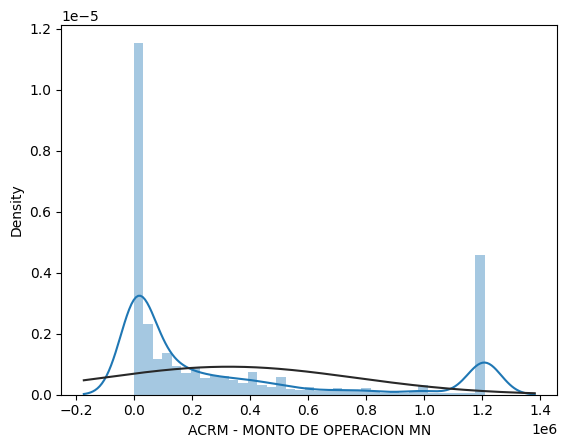

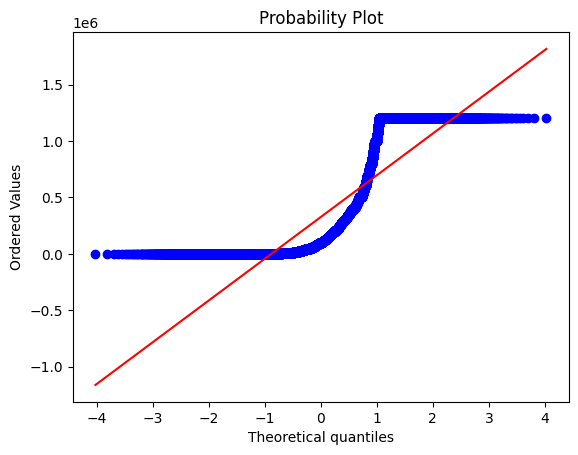

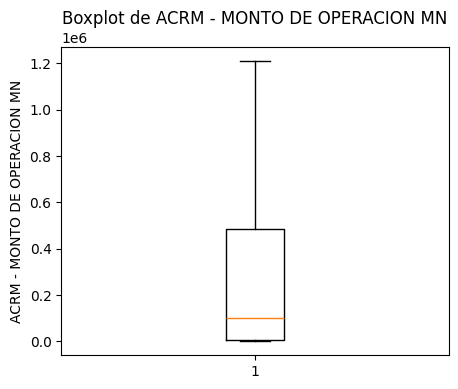

In [ ]:

sns.distplot(df_limpio['ACRM - MONTO DE OPERACION MN'], fit=norm)
fig = plt.figure()
res = stats.probplot(df_limpio['ACRM - MONTO DE OPERACION MN'], plot = plt)

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(df_limpio['ACRM - MONTO DE OPERACION MN'])
plt.ylabel('ACRM - MONTO DE OPERACION MN')
plt.title('Boxplot de ACRM - MONTO DE OPERACION MN')
plt.show()


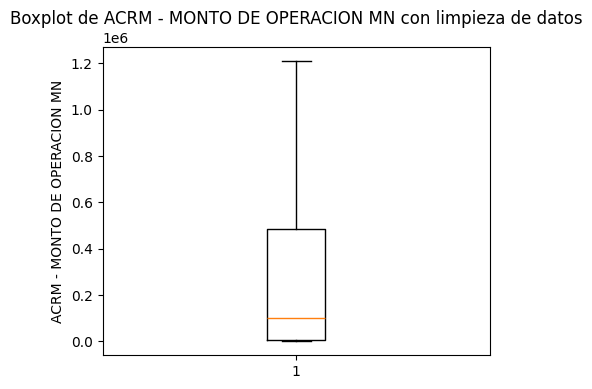

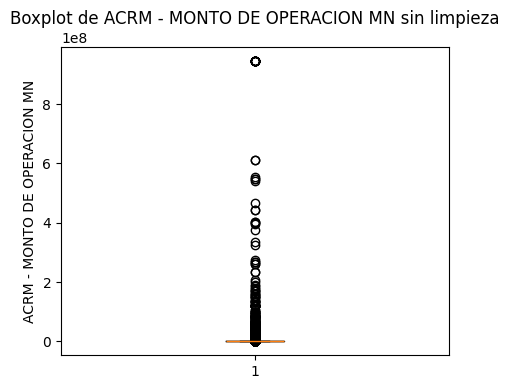

In [ ]:
#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(df_limpio['ACRM - MONTO DE OPERACION MN'])
plt.ylabel('ACRM - MONTO DE OPERACION MN')
plt.title('Boxplot de ACRM - MONTO DE OPERACION MN con limpieza de datos')
plt.show()

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['ACRM - MONTO DE OPERACION MN'])
plt.ylabel('ACRM - MONTO DE OPERACION MN')
plt.title('Boxplot de ACRM - MONTO DE OPERACION MN sin limpieza')
plt.show()


# **ACRM - MONTO EFECTIVO MN **      


In [ ]:
data['ACRM - MONTO EFECTIVO MN'].describe()

,ACRM - MONTO EFECTIVO MN
count,2.461000e+04
mean,1.155263e+06
std,5.601534e+06
min,0.000000e+00
25%,0.000000e+00
50%,5.000000e+04
75%,4.100000e+05
max,1.700000e+08


<ipython-input-68-67c5576dcd0a>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_limpio['ACRM - MONTO EFECTIVO MN'], fit=norm)


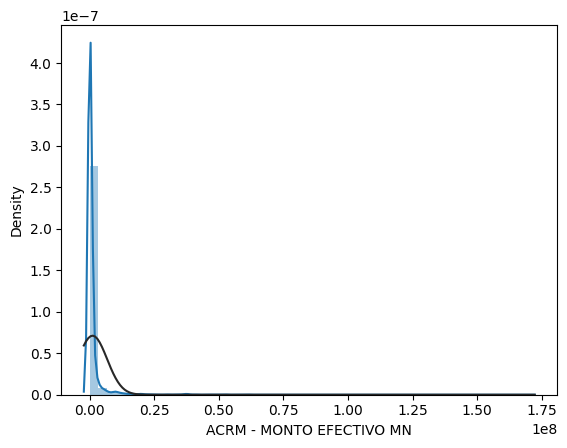

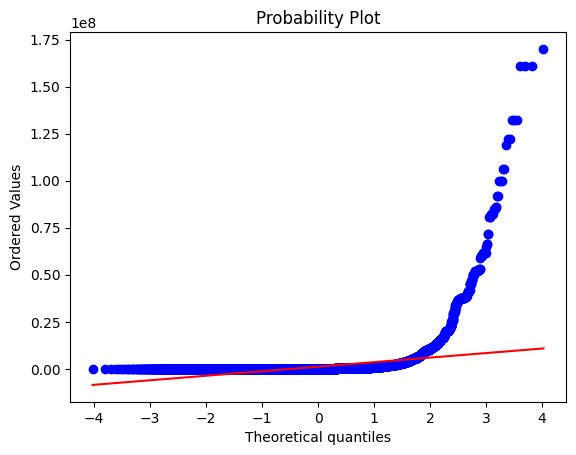

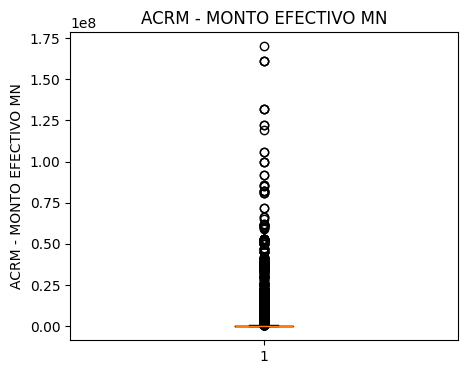

In [ ]:
# Histograma:

sns.distplot(df_limpio['ACRM - MONTO EFECTIVO MN'], fit=norm)
fig = plt.figure()
res = stats.probplot(df_limpio['ACRM - MONTO EFECTIVO MN'], plot = plt)

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['ACRM - MONTO EFECTIVO MN'])
plt.ylabel('ACRM - MONTO EFECTIVO MN')
plt.title('ACRM - MONTO EFECTIVO MN')
plt.show()


Se truncaron las últimas líneas 5000 del resultado de transmisión.
33261              NaN                     0                  6.473748e+06   
33265              NaN                     0                  1.117092e+06   
33266              NaN                     0                  1.156092e+06   
33310              NaN                     0                  1.500000e+06   
33311              NaN                     0                  1.500000e+06   
33312              NaN                     0                  1.200000e+06   
33353              NaN                     0                  1.335533e+06   
33354              NaN                     0                  1.351533e+06   
33394              NaN                     0                  1.428000e+06   
33396              NaN                     0                  1.443000e+06   
33418              NaN                     0                  2.000000e+06   
33419              NaN                     0                  1.105977e+06 

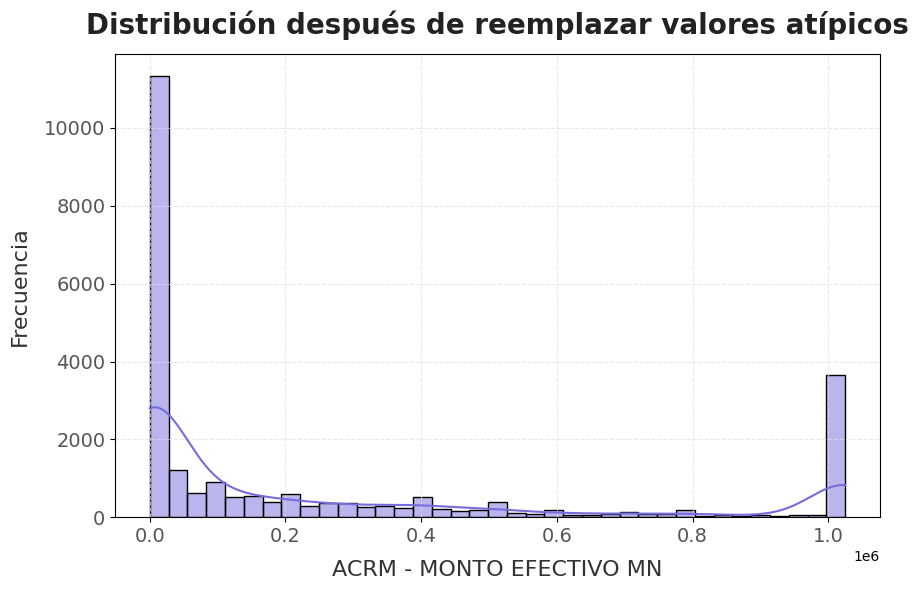

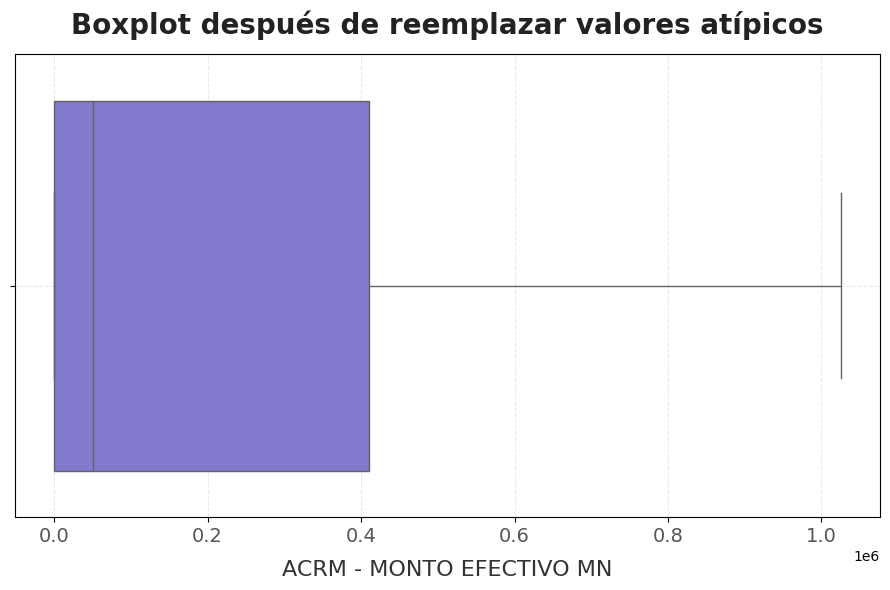

Comparación de estadísticas:
Antes de la limpieza:
                 ID  FECHA EXPEDICION ID  FECHA APERTURA  OFICINA APERTURA  \
count  44084.000000         4.408400e+04    4.408400e+04      44084.000000   
mean   12634.654659         1.867252e+07    2.020942e+07      44358.502790   
std     6564.223104         5.017998e+06    4.715191e+04      49641.674211   
min        1.000000         0.000000e+00    1.971010e+07          1.000000   
25%     7036.750000         1.987031e+07    2.020011e+07         55.000000   
50%    13736.500000         2.002061e+07    2.023033e+07        128.000000   
75%    18164.000000         2.014082e+07    2.024071e+07      99999.000000   
max    23244.000000         2.025022e+07    2.025022e+07      99999.000000   

       SUCURSAL APERTURA  CANAL DE VINCULACION  CLASE DE CLIENTE  \
count       44084.000000          44084.000000               0.0   
mean        44358.502790              4.546752               NaN   
std         49641.674211              4.95

In [ ]:
# Método 1: Detección de valores atípicos usando el rango intercuartílico (IQR)
Q1 = data['ACRM - MONTO EFECTIVO MN'].quantile(0.25)
Q3 = data['ACRM - MONTO EFECTIVO MN'].quantile(0.75)
IQR = Q3 - Q1

# Definir los límites para los valores atípicos
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

print("Límites para valores atípicos:")
print(f"Límite inferior: {limite_inferior}")
print(f"Límite superior: {limite_superior}")

# Identificar los valores atípicos
valores_atipicos = data[(data['ACRM - MONTO EFECTIVO MN'] < limite_inferior) | (data['ACRM - MONTO EFECTIVO MN'] > limite_superior)]
print("\
Valores atípicos identificados:")
print(valores_atipicos)
print(f"Número de valores atípicos: {len(valores_atipicos)}")

# Método 2: Reemplazar los valores atípicos
df_limpio1 = data.copy()

# Opción 1: Reemplazar con los límites
df_limpio1.loc[df_limpio1['ACRM - MONTO EFECTIVO MN'] < limite_inferior, 'ACRM - MONTO EFECTIVO MN'] = limite_inferior
df_limpio1.loc[df_limpio1['ACRM - MONTO EFECTIVO MN'] > limite_superior, 'ACRM - MONTO EFECTIVO MN'] = limite_superior

# Visualizar los datos después de la limpieza
plt.figure(figsize=(9, 6))
sns.histplot(df_limpio1['ACRM - MONTO EFECTIVO MN'], kde=True, color='#766CDB')
plt.title('Distribución después de reemplazar valores atípicos', fontsize=20, fontweight='semibold', color='#222222', pad=15)
plt.xlabel('ACRM - MONTO EFECTIVO MN', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.ylabel('Frecuencia', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.xticks(fontsize=14, color='#555555')
plt.yticks(fontsize=14, color='#555555')
plt.grid(True, linestyle='--', alpha=0.7, color='#E0E0E0')
plt.tight_layout()
plt.show()

# Boxplot después de la limpieza
plt.figure(figsize=(9, 6))
sns.boxplot(x=df_limpio1['ACRM - MONTO EFECTIVO MN'], color='#766CDB')
plt.title('Boxplot después de reemplazar valores atípicos', fontsize=20, fontweight='semibold', color='#222222', pad=15)
plt.xlabel('ACRM - MONTO EFECTIVO MN', fontsize=16, fontweight='medium', color='#333333', labelpad=10)
plt.xticks(fontsize=14, color='#555555')
plt.grid(True, linestyle='--', alpha=0.7, color='#E0E0E0')
plt.tight_layout()
plt.show()

print("Comparación de estadísticas:")
print("\
Antes de la limpieza:")
print(df.describe())
print("\
Después de la limpieza:")
print(df_limpio1.describe())



In [ ]:
df_limpio1['ACRM - MONTO EFECTIVO MN'].describe()

,ACRM - MONTO EFECTIVO MN
count,2.461000e+04
mean,2.674737e+05
std,3.728396e+05
min,0.000000e+00
25%,0.000000e+00
50%,5.000000e+04
75%,4.100000e+05
max,1.025000e+06


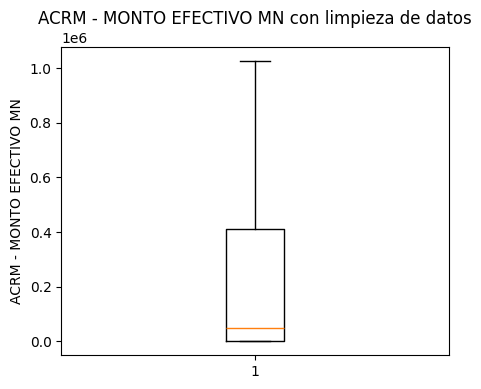

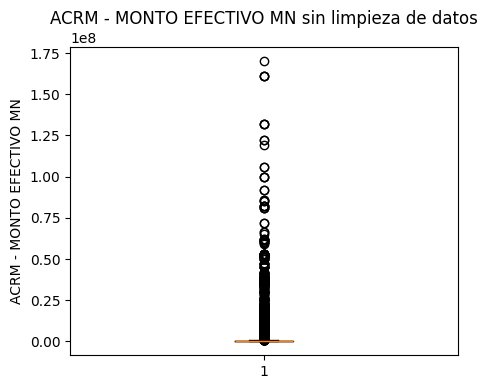

In [ ]:
#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(df_limpio1['ACRM - MONTO EFECTIVO MN'])
plt.ylabel('ACRM - MONTO EFECTIVO MN')
plt.title('ACRM - MONTO EFECTIVO MN con limpieza de datos')
plt.show()

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['ACRM - MONTO EFECTIVO MN'])
plt.ylabel('ACRM - MONTO EFECTIVO MN')
plt.title('ACRM - MONTO EFECTIVO MN sin limpieza de datos')
plt.show()



# **PRODUCTOS CAP-COL**             


In [ ]:
data['PRODUCTOS CAP-COL'].value_counts()

In [ ]:
# Revisamos porcentajes
data['PRODUCTOS CAP-COL'].value_counts("normalize = True")

In [ ]:
data['PRODUCTOS CAP-COL'].describe()

In [ ]:
data['PRODUCTOS CAP-COL'].value_counts().plot(kind="bar")
plt.title("PRODUCTOS CAP-COL ")
plt.xlabel("Nivel de riesgo")
plt.xticks(rotation=0)
plt.ylabel("instances")
plt.show()

#boxplot

plt.figure(figsize=(5, 4))
plt.boxplot(data['PRODUCTOS CAP-COL'])
plt.ylabel('PRODUCTOS CAP-COL')
plt.title('PRODUCTOS CAP-COL')
plt.show()

# Histograma:


sns.distplot(data['PRODUCTOS CAP-COL'], fit=norm)
fig = plt.figure()
res = stats.probplot(data['PRODUCTOS CAP-COL'], plot = plt)

# Esta celda crea un diagrama de pastel

frequency_counts = data['PRODUCTOS CAP-COL'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(frequency_counts, labels=frequency_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Circular Diagram of PRODUCTOS CAP-COL')
plt.axis('equal')
plt.show()



# **ACRM - DEBITO-CREDITO**

In [ ]:
data['ACRM - DEBITO-CREDITO'].value_counts()

In [ ]:
# Revisamos porcentajes
data['ACRM - DEBITO-CREDITO'].value_counts("normalize = True")

In [ ]:
data['ACRM - DEBITO-CREDITO'].describe()

In [ ]:
data['ACRM - DEBITO-CREDITO'].value_counts().plot(kind="bar")
plt.title("ACRM - DEBITO-CREDITO ")
plt.xlabel("Nivel de riesgo")
plt.xticks(rotation=0)
plt.ylabel("instances")
plt.show()

#boxplot

sns.boxplot(data['ACRM - DEBITO-CREDITO'])
plt.title('Boxplot de ACRM - DEBITO-CREDITO')
plt.show()

# Esta celda crea un diagrama de pastel

frequency_counts = data['ACRM - DEBITO-CREDITO'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(frequency_counts, labels=frequency_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Circular Diagram of ACRM - DEBITO-CREDITO')
plt.axis('equal')
plt.show()
